This notebook provides the basic code for reproducing many of the figures in the JAS paper: Primary Modes of Northern Hemisphere Snowfall Particle Size Distributions

Note that the provided example PIP dataset only contains 500 samples from each site which is many orders of magnitude smaller than the full dataset (resulting in more sparse images)

In [58]:
### IMPORTS
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import warnings
import plotly.graph_objects as go # Used for the 3D plotting section (can hide if note needed)
from matplotlib.colors import LogNorm
from sklearn.decomposition import PCA
from matplotlib.lines import Line2D

### NOTEBOOK SETTINGS
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.filterwarnings('ignore')

In [59]:
# DEFINE GLOBALS
path = '../data/pip_snow_obs_10_sites_500_subsample.csv'
palette = ['red', '#0f9adb', 'blue', '#8d2c8d', '#e8b400', '#007e58', 'gray', 'black']
sigma = 2

In [60]:
### LOAD MICROPHYSICS DATA
df = pd.read_csv(path)

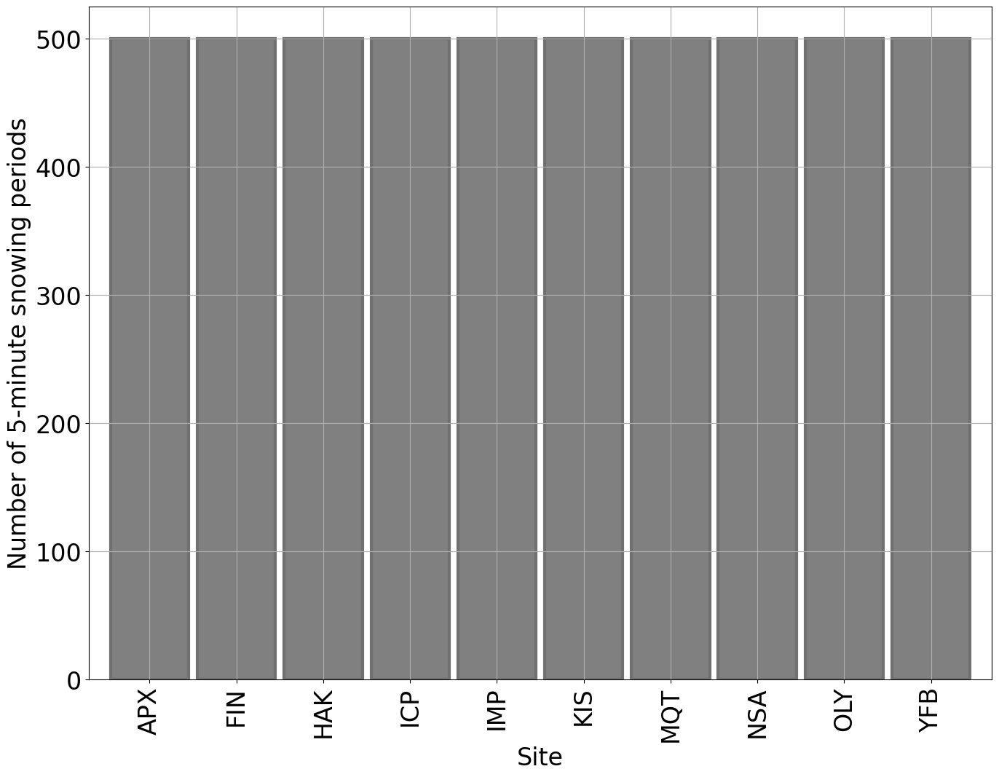

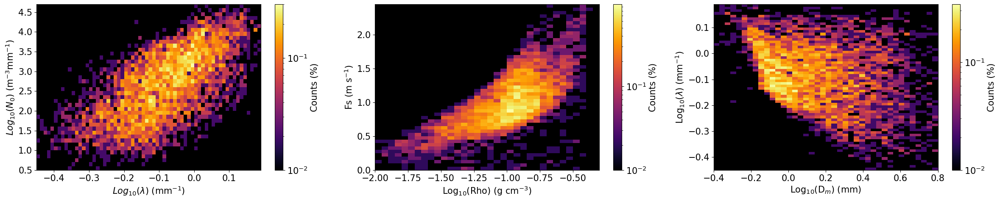

In [61]:
### SAMPLE OVERVIEW
count_df = df
grouped_data = count_df.groupby('site').size()
grouped_data = grouped_data.sort_values(ascending=False)

plt.rcParams.update({'font.size': 24})
fig, ax = plt.subplots(figsize=(16,12))
grouped_data.plot(kind='bar', width=0.9, color='Grey', edgecolor='#707070', linewidth=3)
plt.xlabel('Site')
plt.grid()
plt.ylabel('Number of 5-minute snowing periods')
plt.show()

# Define histogram bin ranges based on known value extremes
bin_N0 = np.arange(0.5, 4.75, 0.1)
bin_lambda = np.arange(-0.45, 0.2, 0.01)
bin_rho = np.arange(-2, -0.25, 0.05)
bin_fs = np.arange(0, 2.5, 0.05)
bin_dm = np.arange(-0.4, 0.8, 0.03)
bin_lambda2 = bin_lambda.copy()
cmap = plt.get_cmap('inferno')
cmap.set_bad(color='black')

# Triple subplot with different particle paramaters plotted against one another
plt.rcParams.update({'font.size': 15})
fig, axes = plt.subplots(1, 3, figsize=(24, 5))
n0_lambda_hist = np.histogram2d(df['lambda_log'], df['n0_log'], (bin_lambda, bin_N0))
hist = 100 * n0_lambda_hist[0].T / np.sum(n0_lambda_hist[0].T)
pcm = axes[0].pcolormesh(bin_lambda, bin_N0, hist, cmap=cmap, norm=LogNorm(vmin=0.01, vmax=hist.max()))
axes[0].set_facecolor('#440154')
axes[0].set_xlabel("$Log_{10}(λ)$ (mm$^{-1}$)")
axes[0].set_ylabel("$Log_{10}(N_{0})$ (m$^{-3}$mm$^{-1}$)")
fig.colorbar(pcm, ax=axes[0], orientation='vertical').set_label("Counts (%)")

rho_fs_hist = np.histogram2d(df['Rho_log'], df['Fs'], (bin_rho, bin_fs))
hist = 100 * rho_fs_hist[0].T / np.sum(rho_fs_hist[0].T)
pcm = axes[1].pcolormesh(bin_rho, bin_fs, hist, cmap=cmap, norm=LogNorm(vmin=0.01, vmax=hist.max()))
axes[1].set_facecolor('#440154')
axes[1].set_xlabel("Log$_{10}$(Rho) (g cm$^{-3}$)")
axes[1].set_ylabel("Fs (m s$^{-1}$)")
fig.colorbar(pcm, ax=axes[1], orientation='vertical').set_label("Counts (%)")

dm_sr_hist = np.histogram2d(df['Dm_log'], df['lambda_log'], (bin_dm, bin_lambda2))
hist = 100 * dm_sr_hist[0].T / np.sum(dm_sr_hist[0].T)
pcm = axes[2].pcolormesh(bin_dm, bin_lambda2, hist, cmap=cmap, norm=LogNorm(vmin=0.01, vmax=hist.max()))
axes[2].set_facecolor('#440154')
axes[2].set_xlabel("Log$_{10}$(D$_m$) (mm)")
axes[2].set_ylabel("Log$_{10}$($\lambda$) (mm$^{-1}$)")
fig.colorbar(pcm, ax=axes[2], orientation='vertical').set_label("Counts (%)")

plt.tight_layout()
plt.show()


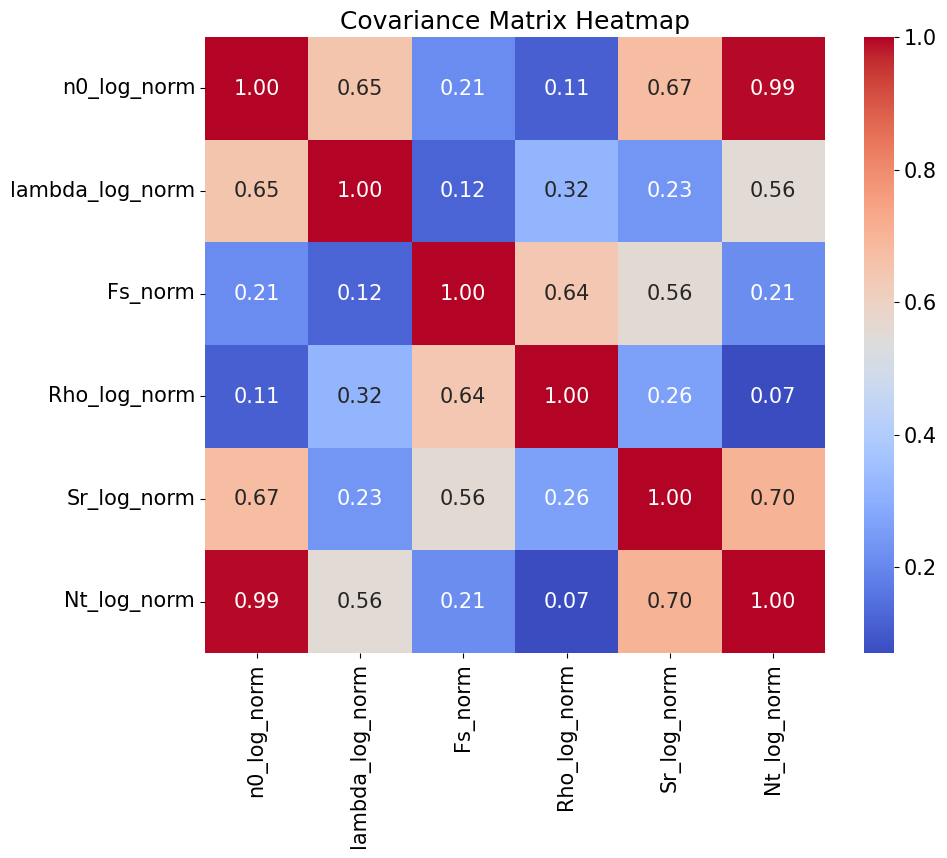

[0.53724549 0.24898737 0.14557339 0.03961587]


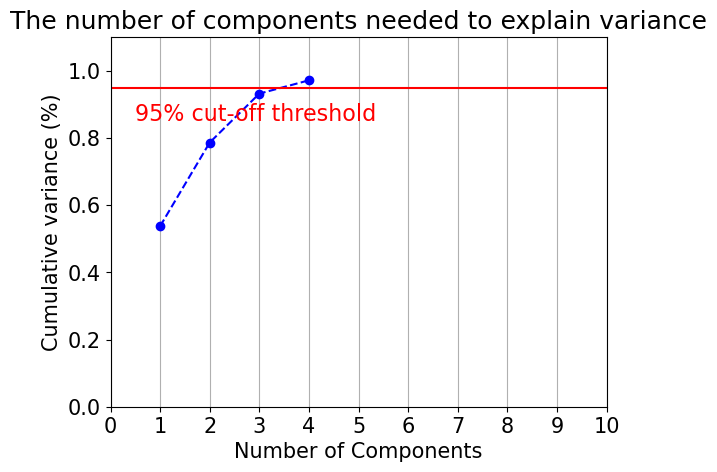

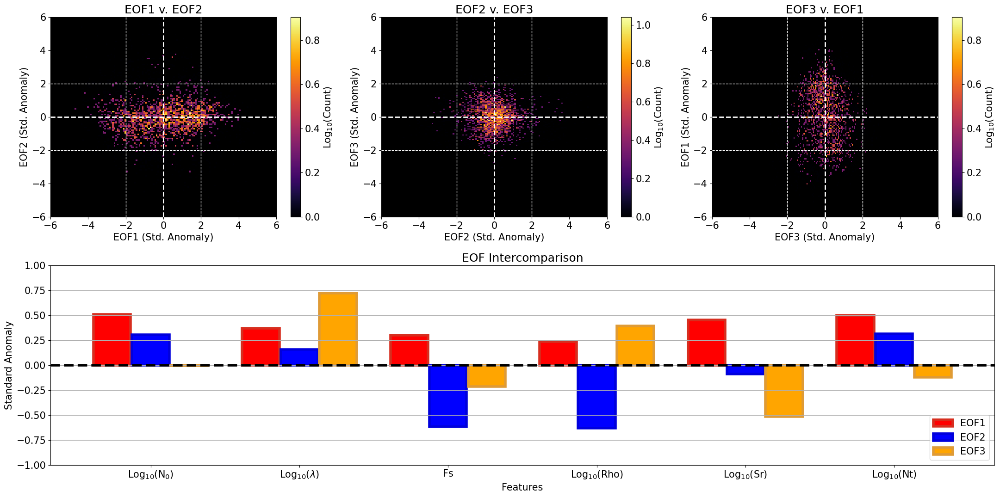

In [62]:
### RUN THE PCA

# show_pca: This function performs the principal component analysis using scikit-learn's 'fit' method
def show_pca(df, colmap):
    # Define features we want to examine
    features = ['n0_log', 'lambda_log', 'Fs', 'Rho_log', 'Sr_log', 'Nt_log']

    # Normalize the features
    for feature in features:
        mean_value = df[feature].mean()
        std_value = df[feature].std()
        df[f"{feature}_norm"] = (df[feature] - mean_value) / std_value
    scaled_data = df.loc[:, ['n0_log_norm', 'lambda_log_norm', 'Fs_norm', 'Rho_log_norm', 'Sr_log_norm', 'Nt_log_norm']].values

    # Calculate the Covariance Matrix (useful for seeing base variable relationships)
    cov_matrix = df.loc[:, ['n0_log_norm', 'lambda_log_norm', 'Fs_norm', 'Rho_log_norm', 'Sr_log_norm', 'Nt_log_norm']].cov()
    plt.figure(figsize=(10, 8))
    sns.heatmap(cov_matrix, annot=True, fmt='.2f', cmap='coolwarm', 
                xticklabels=cov_matrix.columns, yticklabels=cov_matrix.columns)
    plt.title('Covariance Matrix Heatmap')
    plt.show()

    # Perform the PCA (we have an alpha=0.95 as we want to select enough components to explain >= 95% of the variability)
    pca = PCA(n_components = 0.95)
    pca.fit(scaled_data)
    principalComponents = pca.transform(scaled_data)

    cols=[]
    for i in range(principalComponents.shape[1]):
        cols.append('eof' + str(i+1))
    principalDf = pd.DataFrame(data = principalComponents, columns = cols)
    df_all = df.reset_index(drop=True)
    principalDf = principalDf.reset_index(drop=True)
    df_combo = pd.concat([df_all, principalDf], axis=1)

    # Print the explained variance
    print(pca.explained_variance_ratio_)

    # Plot the explained variance so we can see the elbow 
    fig, ax = plt.subplots()
    y = np.cumsum(pca.explained_variance_ratio_)
    xi = np.arange(1, len(y)+1, step=1)
    plt.ylim(0.0,1.1)
    plt.plot(xi, y, marker='o', linestyle='--', color='b')
    plt.xlabel('Number of Components')
    plt.xticks(np.arange(0, 11, step=1)) 
    plt.ylabel('Cumulative variance (%)')
    plt.title('The number of components needed to explain variance')
    plt.axhline(y=0.95, color='r', linestyle='-')
    plt.text(0.5, 0.85, '95% cut-off threshold', color = 'red', fontsize=16)
    ax.grid(axis='x')
    plt.show()

    # make_pca_plot: This is a helper function to make this semi-complex subplot with 4 panels showing the different EOF values wrt. one another
    loadings = pd.DataFrame(pca.components_.T, columns=cols, index=['Log$_{10}$(N${_0}$)', 'Log$_{10}$($\lambda$)', 'Fs', 'Log$_{10}$(Rho)', 'Log$_{10}$(Sr)', 'Log$_{10}$(Nt)'])
    def make_pca_plot(ax, pc_a, pc_b, xlabel, ylabel, title, colmap):
        ax.set_facecolor('white')
        ax.set_facecolor('black')
        extent = 6
        ax.set_title(title)
        ax.set_xlabel(xlabel)
        ax.set_ylabel(ylabel)
        ax.axhline(sigma, linewidth=1, color='white', linestyle='--', zorder=1001)
        ax.axvline(-sigma, linewidth=1, color='white', linestyle='--', zorder=1001)
        ax.axhline(-sigma, linewidth=1, color='white', linestyle='--', zorder=1001)
        ax.axvline(sigma, linewidth=1, color='white', linestyle='--', zorder=1001)
        ax.axhline(0, linewidth=2, color='white', linestyle='--', zorder=1001)
        ax.axvline(0, linewidth=2, color='white', linestyle='--', zorder=1001)
        ax.set_xlim((-extent, extent))
        ax.set_ylim((-extent, extent))

        counts, xedges, yedges = np.histogram2d(pc_a, pc_b, bins=125)
        counts = np.where(counts < 1, np.nan, counts)
        counts = np.log10(counts)
        pcm = ax.pcolormesh(xedges, yedges, counts.T, cmap=colmap, rasterized=True, zorder=1000)
        cbar = plt.colorbar(pcm, ax=ax, label='Log$_{10}$(Count)')
        cbar.ax.minorticks_off()

    # Initialize figure and grid
    fig = plt.figure(figsize=(22, 11))
    gs = gridspec.GridSpec(2, 3)

    # Create PCA plots in first row
    ax1 = fig.add_subplot(gs[0, 0])
    make_pca_plot(ax1, principalDf.eof1, principalDf.eof2, 'EOF1 (Std. Anomaly)', 'EOF2 (Std. Anomaly)', 'EOF1 v. EOF2', colmap)
    ax2 = fig.add_subplot(gs[0, 1])
    make_pca_plot(ax2, principalDf.eof2, principalDf.eof3, 'EOF2 (Std. Anomaly)', 'EOF3 (Std. Anomaly)', 'EOF2 v. EOF3', colmap)
    ax3 = fig.add_subplot(gs[0, 2])
    make_pca_plot(ax3, principalDf.eof3, principalDf.eof1, 'EOF3 (Std. Anomaly)', 'EOF1 (Std. Anomaly)', 'EOF3 v. EOF1', colmap)

    # Create bar plot in second row, spanning entire width
    ax4 = fig.add_subplot(gs[1, :])
    x = np.arange(len(loadings.index))
    bar_width = 0.25
    ax4.bar(x - bar_width-0.01, loadings['eof1'], width=bar_width, color='red', edgecolor='#d72e1f', linewidth=4, label='EOF1')
    ax4.bar(x, loadings['eof2'], width=bar_width, color='blue', edgecolor='#0000dc', linewidth=4,  label='EOF2')
    ax4.bar(x + bar_width+0.01, loadings['eof3'], width=bar_width, color='orange', edgecolor='#df9b36', linewidth=4,  label='EOF3')
    ax4.set_title('EOF Intercomparison')
    ax4.set_ylabel('Standard Anomaly')
    ax4.set_xlabel('Features')
    ax4.set_xticks(x)
    ax4.set_xticklabels(loadings.index)
    ax4.grid(True, axis='y')
    ax4.set_ylim((-1, 1))
    ax4.axhline(0, linewidth=4, linestyle='--', color='black')
    ax4.legend(loc='lower right')

    plt.tight_layout()
    plt.show()

    return df_combo

# Save the combined df, pairing the microphysical values with their respective PCA-derived EOF values
df_combo = show_pca(df, 'inferno')

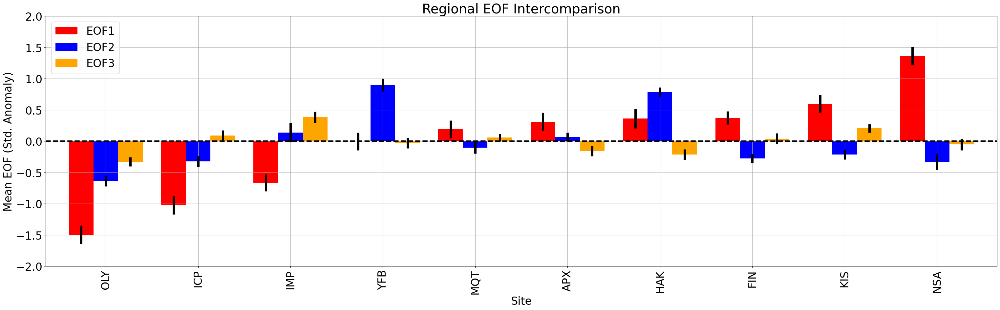

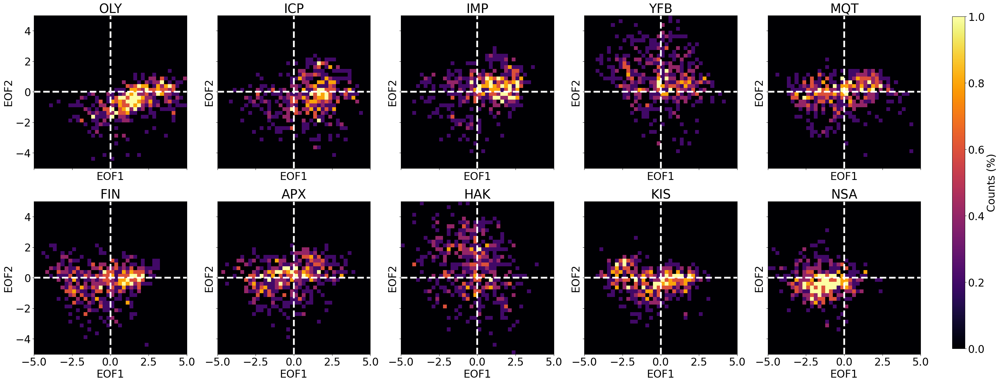

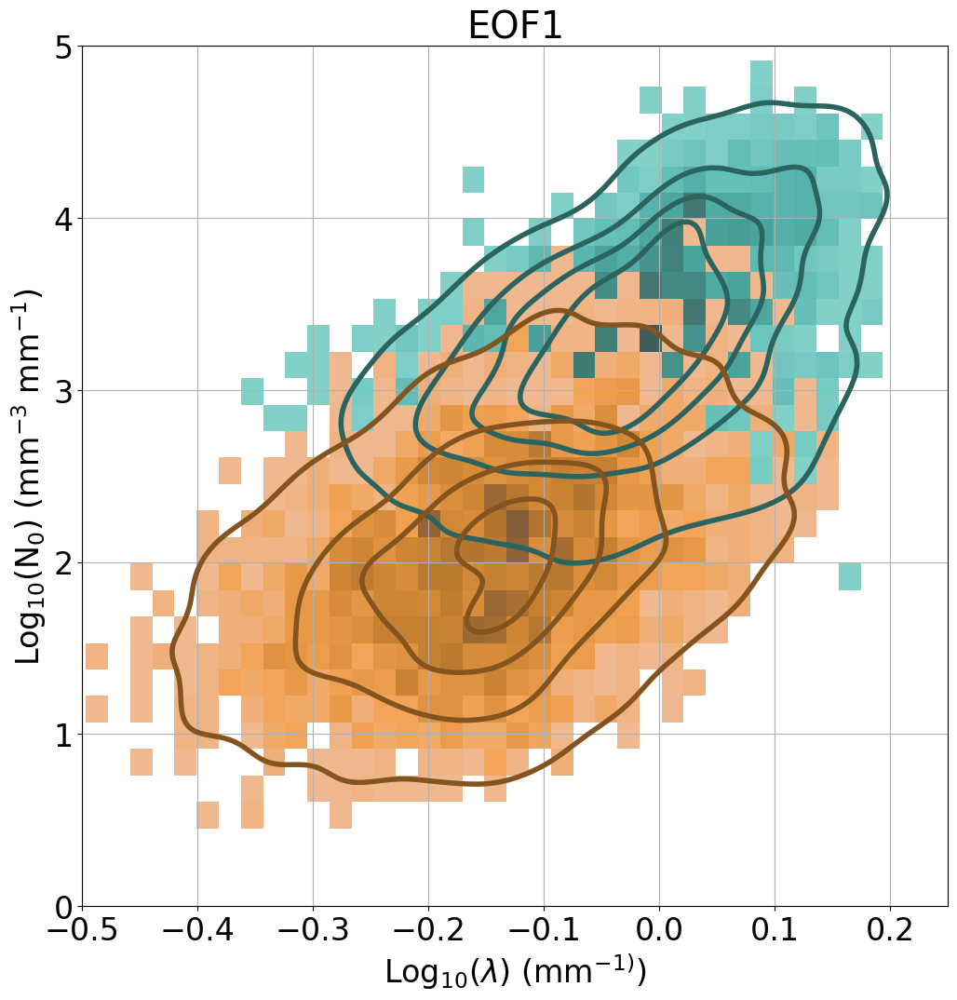

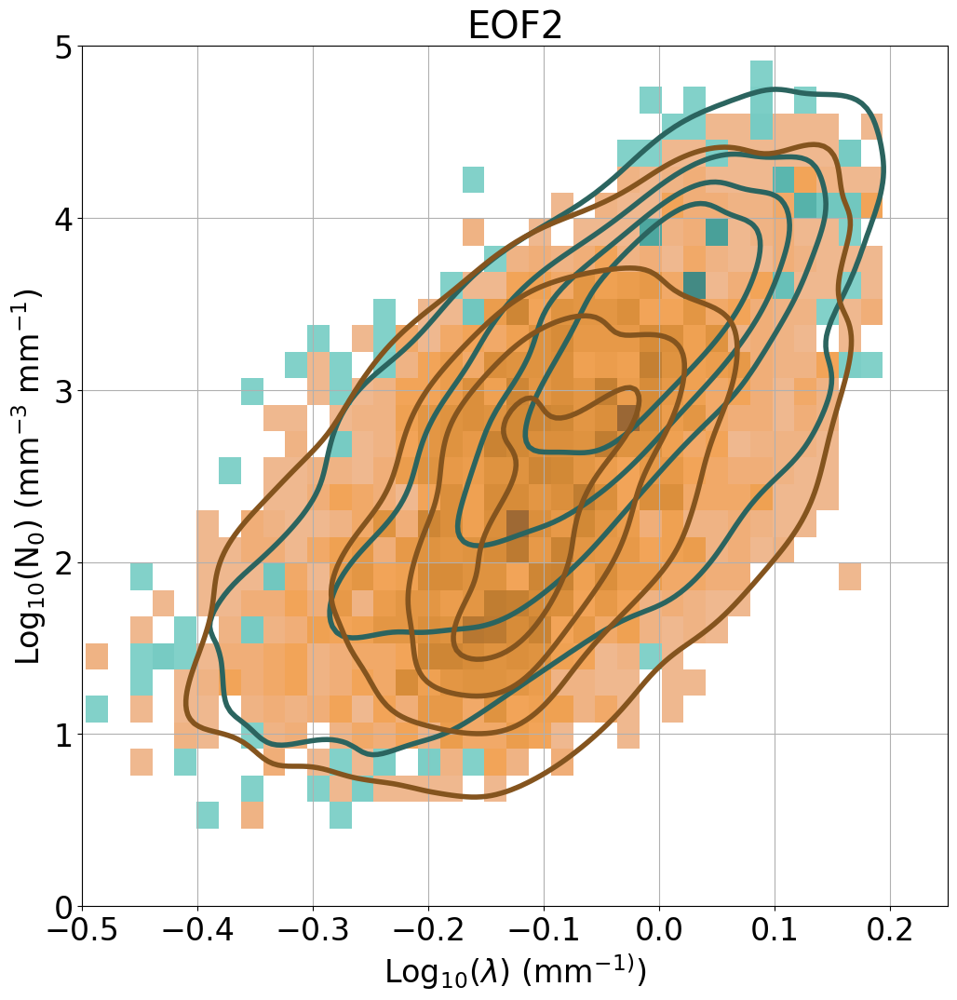

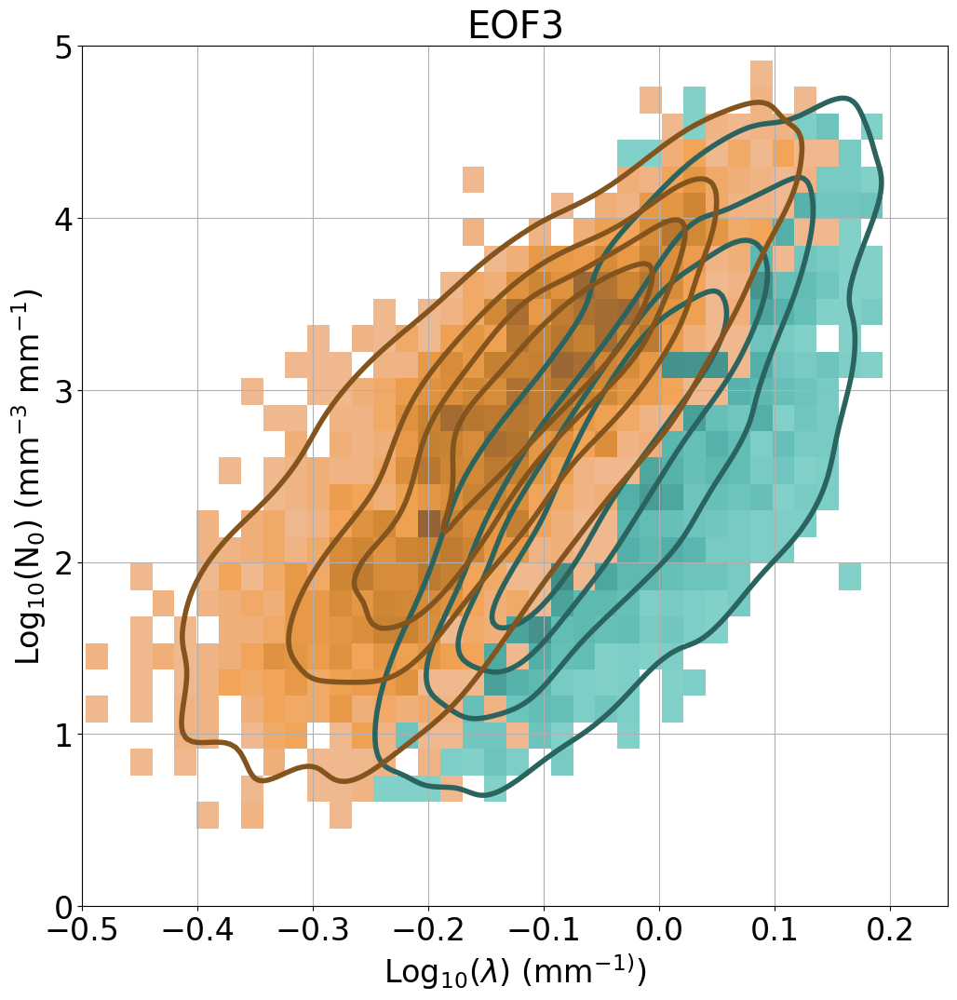

In [63]:

### SPATIAL EOF DISTRIBUTIONS
df_combo['eof1_dir'] = df_combo['eof1'].apply(lambda x: 'pos' if x > 0 else 'neg')
df_combo['eof2_dir'] = df_combo['eof2'].apply(lambda x: 'pos' if x > 0 else 'neg')
df_combo['eof3_dir'] = df_combo['eof3'].apply(lambda x: 'pos' if x > 0 else 'neg')

# plot_pca_pos_neg: Helper function to plot spatial differences between EOFs
def plot_pca_pos_neg():
    mean_eof1 = df_combo.groupby('site')['eof1'].mean()
    mean_eof2 = df_combo.groupby('site')['eof2'].mean()
    mean_eof3 = df_combo.groupby('site')['eof3'].mean()
    std_eof1 = df_combo.groupby('site')['eof1'].std()
    std_eof2 = df_combo.groupby('site')['eof2'].std()
    std_eof3 = df_combo.groupby('site')['eof3'].std()
    counts = df_combo.groupby('site').size()
    z = 1.96  # z-score for a 95% confidence interval
    ci_eof1 = z * (std_eof1 / np.sqrt(counts))
    ci_eof2 = z * (std_eof2 / np.sqrt(counts))
    ci_eof3 = z * (std_eof3 / np.sqrt(counts))
    means = pd.DataFrame({
        'EOF1': -mean_eof1,
        'EOF2': mean_eof2,
        'EOF3': -mean_eof3
    })
    means = means.sort_values('EOF1')
    plt.rcParams.update({'font.size': 24})
    ax = means.plot(kind='bar', yerr=[ci_eof1, ci_eof2, ci_eof3], color=['red', 'blue', 'orange'], linewidth=5, figsize=(31, 10), width=0.8, error_kw=dict(lw=5))
    plt.grid()
    plt.axhline(0, linestyle='--', color='black', linewidth=3)
    plt.ylabel('Mean EOF (Std. Anomaly)')
    plt.xlabel('Site')
    plt.title('Regional EOF Intercomparison')
    plt.ylim((-2,2))
    plt.tight_layout()
    plt.show()

    df = df_combo

    # plot_site_eofs: Another helpfer function to plot joint EOF distributions per site
    def plot_site_eofs(first, second):
        plt.rcParams.update({'font.size': 24})
        fig, axs = plt.subplots(2, 5, figsize=(40, 14), sharex=True, sharey=True)
        axs = axs.ravel()
        images = []

        sites = ['OLY', 'ICP', 'IMP', 'YFB', 'MQT', 'FIN', 'APX', 'HAK', 'KIS', 'NSA']

        for i, site in enumerate(sites):
            site_data = df[df['site'] == site]
            x = site_data[first]
            y = site_data[second]
            total_count = len(x)
            h, xedges, yedges = np.histogram2d(x, y, bins=(40, 40), range=[[-5, 5], [-5, 5]])
            h = (h / total_count) * 100

            im = axs[i].imshow(h.T, extent=[-5, 5, -5, 5], origin='lower', cmap='inferno', vmin=0, vmax=1)
            images.append(im)
            axs[i].set_facecolor('black')
            axs[i].set_title(site)
            axs[i].set_xlabel('EOF1')
            axs[i].set_ylabel('EOF2')
            axs[i].axhline(0, color='white', linestyle='--', linewidth=4)
            axs[i].axvline(0, color='white', linestyle='--', linewidth=4)
            axs[i].set_xlim(-5, 5)
            axs[i].set_ylim(-5, 5)

        plt.subplots_adjust(right=0.825)

        cbar_ax = fig.add_axes([0.85, 0.125, 0.01, 0.75])
        cbar = fig.colorbar(images[0], cax=cbar_ax)
        cbar.ax.set_ylabel('Counts (%)')

        plt.show()

    plot_site_eofs('eof1', 'eof2')
    # plot_site_eofs('eof2', 'eof3')
    # plot_site_eofs('eof3', 'eof1')

    plt.rcParams.update({'font.size': 24})
    fig, ax = plt.subplots(figsize=(12,12))
    plt.grid()
    ax.set_xlim((-0.5, 0.25))
    ax.set_ylim((0, 5))
    sns.histplot(df_combo, x="lambda_log", y="n0_log", hue="eof1_dir", hue_order=['pos', 'neg'], palette={'pos':'#2b645f', 'neg':'#84541e'})
    sns.kdeplot(df_combo, x="lambda_log", y="n0_log", hue="eof1_dir", hue_order=['pos', 'neg'], levels=5, linewidths=4, palette={'pos':'#2b645f', 'neg':'#84541e'})
    plt.legend([],[], frameon=False)
    plt.xlabel("Log$_{10}$($\lambda$) (mm$^{-1)}$)")
    plt.ylabel("Log$_{10}$(N$_{0}$) (mm$^{-3}$ mm$^{-1}$)")
    plt.title("EOF1")
    plt.show()

    fig, ax = plt.subplots(figsize=(12,12))
    ax.set_xlim((-0.5, 0.25))
    ax.set_ylim((0, 5))
    plt.grid()
    sns.histplot(df_combo, x="lambda_log", y="n0_log", hue="eof2_dir", hue_order=['pos', 'neg'], palette={'pos':'#2b645f', 'neg':'#84541e'})
    sns.kdeplot(df_combo, x="lambda_log", y="n0_log", hue="eof2_dir", hue_order=['pos', 'neg'], levels=5, linewidths=4, palette={'pos':'#2b645f', 'neg':'#84541e'})
    plt.legend([],[], frameon=False)
    plt.xlabel("Log$_{10}$($\lambda$) (mm$^{-1)}$)")
    plt.ylabel("Log$_{10}$(N$_{0}$) (mm$^{-3}$ mm$^{-1}$)")
    plt.title("EOF2")
    plt.show()

    fig, ax = plt.subplots(figsize=(12,12))
    ax.set_xlim((-0.5, 0.25))
    ax.set_ylim((0, 5))
    plt.grid()
    sns.histplot(df_combo, x="lambda_log", y="n0_log", hue="eof3_dir", hue_order=['pos', 'neg'], palette={'pos':'#2b645f', 'neg':'#84541e'})
    sns.kdeplot(df_combo, x="lambda_log", y="n0_log", hue="eof3_dir", hue_order=['pos', 'neg'], levels=5, linewidths=4, palette={'pos':'#2b645f', 'neg':'#84541e'})
    plt.legend([],[], frameon=False)
    plt.xlabel("Log$_{10}$($\lambda$) (mm$^{-1)}$)")
    plt.ylabel("Log$_{10}$(N$_{0}$) (mm$^{-3}$ mm$^{-1}$)")
    plt.title("EOF3")
    plt.show()

plot_pca_pos_neg()



In [64]:

### 3D GROUP PLOTTING
new_df = df_combo[['n0_log', 'lambda_log', 'Rho_log', 'Nt_log', 'Sr_log', 'Fs', 'Dm', 'eof1', 'eof2', 'eof3']]

# plot_3d_clusters: Helper to assign PC groups based on sigma value and plot in 3D
def plot_3d_clusters(df):
    groups = {
        1: [
            [[-np.inf, -sigma], [-np.inf, np.inf], [-sigma, sigma]]
        ],
        2: [
            [[-sigma, sigma], [sigma, np.inf], [-np.inf, np.inf]]
        ],
        3: [
            [[sigma, np.inf], [-np.inf, np.inf], [-sigma, sigma]]
        ],
        4: [
            [[-sigma, sigma], [-np.inf, -sigma], [-np.inf, np.inf]]
        ],
        5: [
            [[-np.inf, np.inf], [-sigma, sigma], [sigma, np.inf]]
        ],
        6: [
            [[-np.inf, np.inf], [-sigma, sigma], [-np.inf, -sigma]]
        ]
    }

    def assign_group(row):
        for group, conditions in groups.items():
            for condition in conditions:
                range1, range2, range3 = condition
                if range1[0] <= row['eof1'] <= range1[1] and range2[0] <= row['eof2'] <= range2[1] and range3[0] <= row['eof3'] <= range3[1]:
                    return group
        return 7
    
    df['group'] = df.apply(assign_group, axis=1)
    df = df[df['n0_log'] >= 0]
    df = df[df['Fs'] >= 0]
    df = df[df['Fs'] <= 3]
    df = df[df['Rho_log'] >= -2]
    df = df[df['lambda_log'] <= 0.5]

    # 3D visualization of groups
    fig = go.Figure()
    for group, color in enumerate(palette, start=1):
        group_df = df[df['group'] == group]
        fig.add_trace(go.Scatter3d(
            x=group_df['eof1'], 
            y=group_df['eof2'], 
            z=group_df['eof3'], 
            mode='markers',
            marker=dict(color=color, size=2),  # Make points small as you mentioned
            name=f"Group {group}"
        ))
    fig.update_layout(scene=dict(aspectmode='cube', 
                                 xaxis=dict(title="PC1", title_font=dict(size=24), tickfont=dict(size=15)),
                                 yaxis=dict(title="PC2", title_font=dict(size=24), tickfont=dict(size=15)),
                                 zaxis=dict(title="PC3", title_font=dict(size=24), tickfont=dict(size=15))),
                                width=1000, height=1000)
    fig.show()

    # Interactive cube plot in 3D
    data = df[['eof1', 'eof2', 'eof3']].values
    x = np.linspace(data[:, 0].min(), data[:, 0].max(), 30)
    y = np.linspace(data[:, 1].min(), data[:, 1].max(), 30)
    z = np.linspace(data[:, 2].min(), data[:, 2].max(), 30)
    X, Y, Z = np.meshgrid(x, y, z)

    ## TEST DRAW
    def handle_infs(value, positive=True):
        if positive:
            return value if np.isfinite(value) else 2*sigma
        else:
            return value if np.isfinite(value) else -2*sigma

    # Make a flattened version of the groups dictionary
    flattened_ranges = {}
    idx = 1
    for group, conditions in groups.items():
        for condition in conditions:
            flattened_ranges[idx] = [
                [handle_infs(condition[0][0], False), handle_infs(condition[0][1])],
                [handle_infs(condition[1][0], False), handle_infs(condition[1][1])],
                [handle_infs(condition[2][0], False), handle_infs(condition[2][1])]
            ]
            idx += 1

    plt.rcParams.update({'font.size': 55})

    fig = go.Figure()
    for key, r in flattened_ranges.items():
        x_vals = np.random.uniform(r[0][0], r[0][1], 50000)
        y_vals = np.random.uniform(r[1][0], r[1][1], 50000)
        z_vals = np.random.uniform(r[2][0], r[2][1], 50000)
        color = palette[key-1]
        fig.add_trace(go.Scatter3d(x=x_vals, y=y_vals, z=z_vals, mode='markers', marker=dict(color=color, size=3)))

    fig.update_layout(scene=dict(aspectmode='cube', 
                                 xaxis=dict(title="PC1", title_font=dict(size=24), tickfont=dict(size=15)),
                                 yaxis=dict(title="PC2", title_font=dict(size=24), tickfont=dict(size=15)),
                                 zaxis=dict(title="PC3", title_font=dict(size=24), tickfont=dict(size=15))),
                                width=1000, height=1000)
    fig.show()


plot_3d_clusters(new_df)


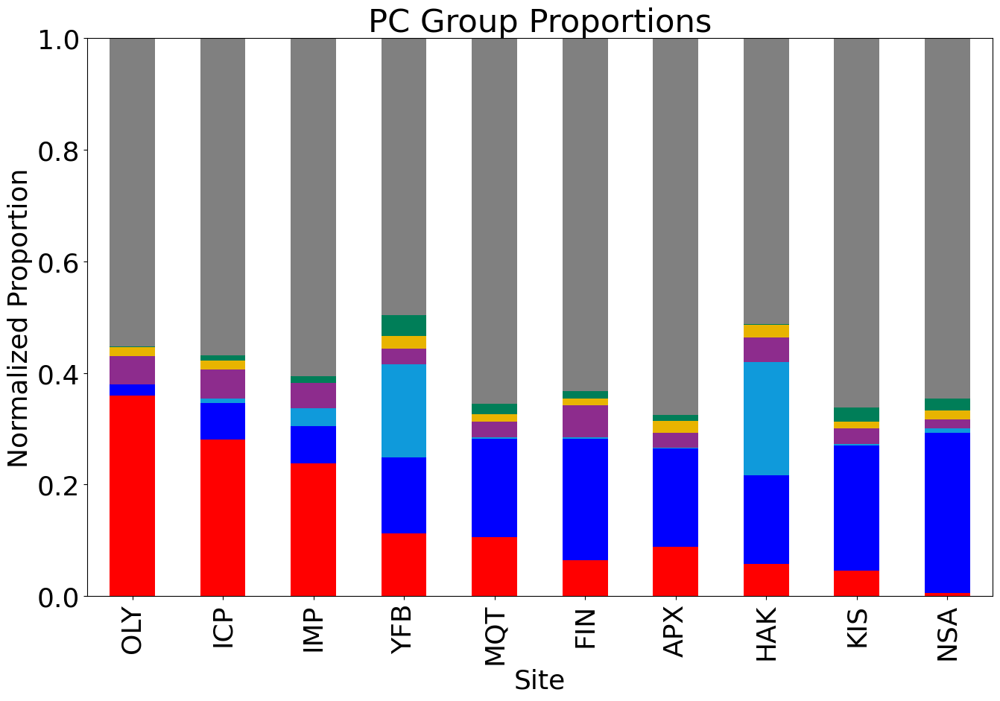

PC group proportions by site:
group      1      2      3      4      5      6      7
site                                                  
OLY    0.360  0.020  0.000  0.050  0.016  0.002  0.552
ICP    0.280  0.066  0.008  0.052  0.016  0.010  0.568
IMP    0.238  0.066  0.032  0.046  0.000  0.012  0.606
YFB    0.112  0.136  0.168  0.028  0.022  0.038  0.496
MQT    0.106  0.176  0.002  0.028  0.014  0.018  0.656
FIN    0.064  0.218  0.002  0.058  0.012  0.014  0.632
APX    0.088  0.176  0.002  0.026  0.022  0.010  0.676
HAK    0.058  0.158  0.204  0.044  0.022  0.002  0.512
KIS    0.046  0.224  0.002  0.028  0.012  0.026  0.662
NSA    0.006  0.286  0.008  0.016  0.016  0.022  0.646


In [65]:
### ASSIGN PC GROUPS TO DATASET BASED ON EOF VALUES AND SIGMA
plt.rcParams.update({'font.size': 26})

groups = {
    1: [
        [[-np.inf, -sigma], [-np.inf, np.inf], [-sigma, sigma]]
    ],
    2: [
        [[-sigma, sigma], [sigma, np.inf], [-np.inf, np.inf]]
    ],
    3: [
        [[sigma, np.inf], [-np.inf, np.inf], [-sigma, sigma]]
    ],
    4: [
        [[-sigma, sigma], [-np.inf, -sigma], [-np.inf, np.inf]]
    ],
    5: [
        [[-np.inf, np.inf], [-sigma, sigma], [sigma, np.inf]]
    ],
    6: [
        [[-np.inf, np.inf], [-sigma, sigma], [-np.inf, -sigma]]
    ]
}

def assign_group(row):
    for group, conditions in groups.items():
        for condition in conditions:
            range1, range2, range3 = condition
            if range1[0] <= row['eof1'] <= range1[1] and range2[0] <= row['eof2'] <= range2[1] and range3[0] <= row['eof3'] <= range3[1]:
                return group
    return 7

df_combo['group'] = df_combo.apply(assign_group, axis=1)

palette_custom = ['red', 'blue', '#0f9adb', '#8d2c8d', '#e8b400', '#007e58', 'gray', 'black']
count_df = pd.crosstab(df_combo['site'], df_combo['group'])
normalized_df = count_df.div(count_df.sum(axis=1), axis=0)
normalized_df = normalized_df.sort_values(by=7)
normalized_df[[2, 3]] = normalized_df[[3, 2]]
normalized_df[[1, 2]] = normalized_df[[2, 1]]
new_order = ['OLY', 'ICP', 'IMP', 'YFB', 'MQT', 'FIN', 'APX', 'HAK', 'KIS', 'NSA']
normalized_df = normalized_df.loc[new_order]
ax = normalized_df.plot(kind='bar', stacked=True, figsize=(14,10), color=palette_custom, legend=None)
plt.title('PC Group Proportions')
plt.xlabel('Site')
plt.ylabel('Normalized Proportion')
plt.ylim(0, 1)
plt.tight_layout()
plt.show()

print("PC group proportions by site:")
print(normalized_df)


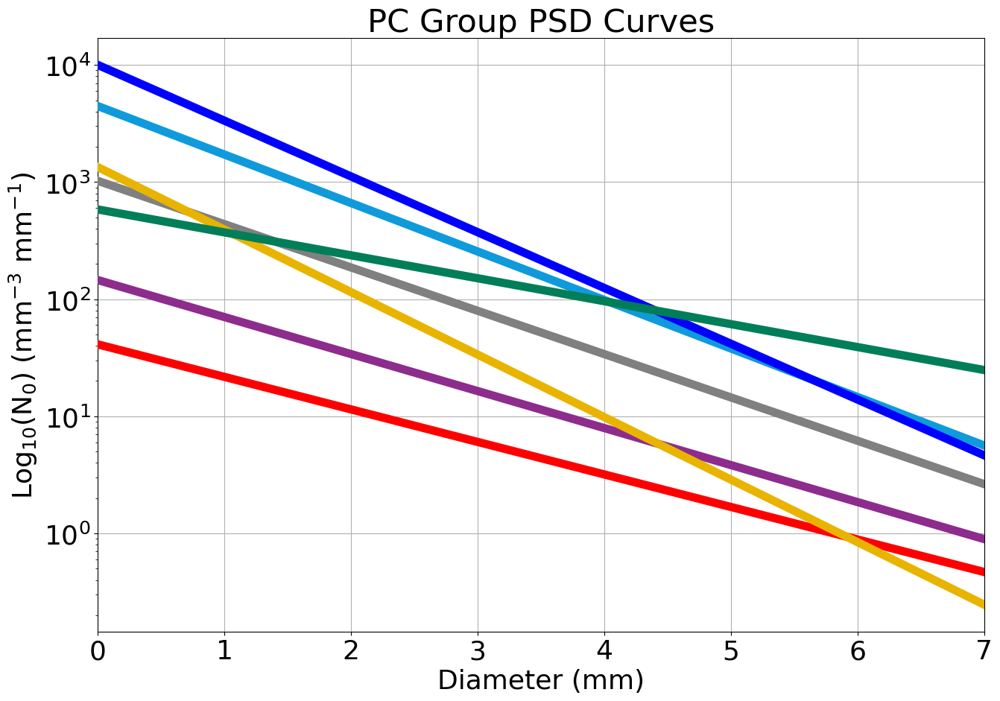

In [66]:
### CALCULATE MEAN PSD VALUES
df= df_combo
df = df[df['n0_log'] >= 0]
df = df[df['Fs'] >= 0]
df = df[df['Fs'] <= 3]
df = df[df['Rho_log'] >= -2]
df = df[df['lambda_log'] <= 0.5]

grouped_means = df.groupby('group')[['n0', 'lambda']].mean()
def func(t, a, b):
    return a * np.exp(-b * t)

plt.rcParams.update({'font.size': 26})
t_values = np.linspace(0, 7, 400)
plt.figure(figsize=(14, 10))

zorder=1001
for group, row in grouped_means.iterrows():
    y_values = func(t_values, row['n0'], row['lambda'])
    if group == 7:
        zorder=900
    plt.plot(t_values, y_values, label=f'Group {group}', color=palette[group-1], linewidth=8, zorder=zorder)

plt.title('PC Group PSD Curves')
plt.xlabel('Diameter (mm)')
plt.ylabel('Log$_{10}$(N$_0$) (mm$^{-3}$ mm$^{-1}$)')
plt.xlim((0, 7))
plt.yscale('log')
plt.grid(True)
plt.tight_layout()
plt.show()


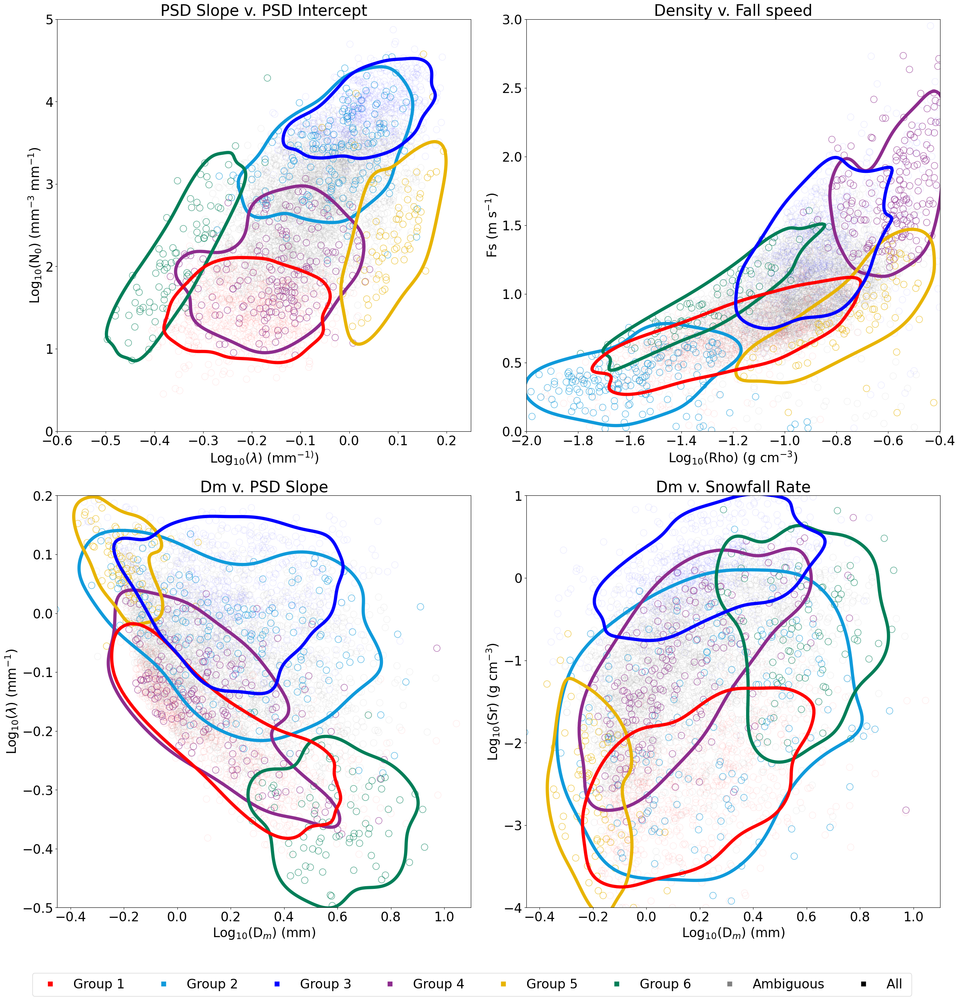

In [67]:
### VARIABLE SPACE MULTIPLOT

# plot_groups_detail: Helper for plotting PC groups in different spaces
def plot_groups_detail(df):
    df = df[df['n0_log'] >= 0]
    df = df[df['Fs'] >= 0]
    df = df[df['Fs'] <= 3]
    df = df[df['Rho_log'] >= -2]
    df = df[df['lambda_log'] <= 0.5]
    final_df = df[['n0_log', 'lambda_log', 'Fs', 'Sr_log', 'Nt_log', "Rho_log", 'Dm_log', 'eof1', 'eof2', 'eof3', 'group']]

    ambig = final_df[final_df['group'] == 7] # gray
    group1 = final_df[final_df['group'] == 1] # red
    group2 = final_df[final_df['group'] == 2] # 009B76
    group3 = final_df[final_df['group'] == 3] # blue
    group4 = final_df[final_df['group'] == 4] # purple
    group5 = final_df[final_df['group'] == 5] # CC5500
    group6 = final_df[final_df['group'] == 6] # 65000B

    def plot_data_and_kde(data, x_col, y_col, color, ax, scatter_alpha=0.66):
        ax.scatter(data[x_col], data[y_col], s=150, alpha=scatter_alpha, edgecolor=color, facecolor='none', label=f"Group {data['group'].iloc[0]}")
        sns.kdeplot(x=data[x_col], y=data[y_col], ax=ax, color=color, levels=[0.2], Fill=True, linewidths=6)

    # Multisubplot with PC groups plotted against one another in different physical variable spaces
    plt.rcParams.update({'font.size': 24})
    fig, axes = plt.subplots(2, 2, figsize=(25, 25))
    ax = axes[0][0]
    ax.set_title("PSD Slope v. PSD Intercept")
    ax.set_xlabel("Log$_{10}$($\lambda$) (mm$^{-1)}$)")
    ax.set_ylabel("Log$_{10}$(N$_{0}$) (mm$^{-3}$ mm$^{-1}$)")
    # ax.scatter(final_df.lambda_log, final_df.n0_log,  s=150, alpha=0.1, edgecolor='black', facecolor='none')
    ax.scatter(ambig.lambda_log, ambig.n0_log,  s=150, alpha=0.1, edgecolor='gray', facecolor='none')
    plot_data_and_kde(group2, 'lambda_log', 'n0_log', '#0f9adb', ax)
    plot_data_and_kde(group4, 'lambda_log', 'n0_log', '#8d2c8d', ax)
    plot_data_and_kde(group5, 'lambda_log', 'n0_log', '#e8b400', ax)
    plot_data_and_kde(group6, 'lambda_log', 'n0_log', '#007e58', ax)
    plot_data_and_kde(group1, 'lambda_log', 'n0_log', 'red', ax, scatter_alpha=0.075)
    plot_data_and_kde(group3, 'lambda_log', 'n0_log', 'blue', ax, scatter_alpha=0.075)
    ax.set_ylim((0, 5))
    ax.set_xlim((-0.6, 0.25))

    ax = axes[0][1]
    ax.set_title("Density v. Fall speed")
    ax.set_xlabel("Log$_{10}$(Rho) (g cm$^{-3}$)")
    ax.set_ylabel("Fs (m s$^{-1}$)")
    # ax.scatter(final_df.Rho_log, final_df.Fs,  s=150, alpha=0.1, edgecolor='black', facecolor='none')
    ax.scatter(ambig.Rho_log, ambig.Fs,  s=150, alpha=0.1, edgecolor='gray', facecolor='none')
    plot_data_and_kde(group2, 'Rho_log', 'Fs', '#0f9adb', ax)
    plot_data_and_kde(group4, 'Rho_log', 'Fs', '#8d2c8d', ax)
    plot_data_and_kde(group5, 'Rho_log', 'Fs', '#e8b400', ax)
    plot_data_and_kde(group6, 'Rho_log', 'Fs', '#007e58', ax)
    plot_data_and_kde(group1, 'Rho_log', 'Fs', 'red', ax, scatter_alpha=0.075)
    plot_data_and_kde(group3, 'Rho_log', 'Fs', 'blue', ax, scatter_alpha=0.075)
    ax.set_xlim((-2, np.max(final_df.Rho_log)))
    ax.set_ylim((0, 3))

    ax = axes[1][0]
    ax.set_title("Dm v. PSD Slope")
    ax.set_xlabel("Log$_{10}$(D$_m$) (mm)")
    ax.set_ylabel("Log$_{10}$($\lambda$) (mm$^{-1}$)")
    # ax.scatter(final_df.Dm_log, final_df.lambda_log,  s=150, alpha=0.1, edgecolor='black', facecolor='none')
    ax.scatter(ambig.Dm_log, ambig.lambda_log,  s=150, alpha=0.1, edgecolor='gray', facecolor='none')
    plot_data_and_kde(group2, 'Dm_log', 'lambda_log', '#0f9adb', ax)
    plot_data_and_kde(group4, 'Dm_log', 'lambda_log', '#8d2c8d', ax)
    plot_data_and_kde(group5, 'Dm_log', 'lambda_log', '#e8b400', ax)
    plot_data_and_kde(group6, 'Dm_log', 'lambda_log', '#007e58', ax)
    plot_data_and_kde(group1, 'Dm_log', 'lambda_log', 'red', ax, scatter_alpha=0.075)
    plot_data_and_kde(group3, 'Dm_log', 'lambda_log', 'blue', ax, scatter_alpha=0.075)
    ax.set_ylim((-0.5, 0.2))
    ax.set_xlim((-0.45, 1.1))

    ax = axes[1][1]
    ax.set_title("Dm v. Snowfall Rate")
    ax.set_xlabel("Log$_{10}$(D$_m$) (mm)")
    ax.set_ylabel("Log$_{10}$(Sr) (g cm$^{-3}$)")
    # ax.scatter(final_df.Dm_log, final_df.Sr_log,  s=150, alpha=0.1, edgecolor='black', facecolor='none')
    ax.scatter(ambig.Dm_log, ambig.Sr_log,  s=150, alpha=0.1, edgecolor='gray', facecolor='none')
    plot_data_and_kde(group2, 'Dm_log', 'Sr_log', '#0f9adb', ax)
    plot_data_and_kde(group4, 'Dm_log', 'Sr_log', '#8d2c8d', ax)
    plot_data_and_kde(group5, 'Dm_log', 'Sr_log', '#e8b400', ax)
    plot_data_and_kde(group6, 'Dm_log', 'Sr_log', '#007e58', ax)
    plot_data_and_kde(group1, 'Dm_log', 'Sr_log', 'red', ax, scatter_alpha=0.075)
    plot_data_and_kde(group3, 'Dm_log', 'Sr_log', 'blue', ax, scatter_alpha=0.075)
    ax.set_ylim((-4, 1))
    ax.set_xlim((-0.45, 1.1))

    group_labels = ["Group 1", "Group 2", "Group 3", "Group 4", "Group 5", "Group 6", "Ambiguous", "All "]
    legend_elements = [Line2D([0], [0], marker='s', color='w', label=group_labels[i], markerfacecolor=color, markersize=10) for i, color in enumerate(palette)]
    fig.legend(legend_elements, group_labels, loc='lower center', bbox_to_anchor=(0.5, -0.05), ncol=len(groups) + 2)

    plt.tight_layout()
    plt.show()

plot_groups_detail(df)




In [68]:
print("All done!")

All done!
